In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



In [8]:


import numpy as np
import warnings
warnings.filterwarnings("ignore")


https://www.datacamp.com/es/tutorial/xgboost-in-python

In [9]:
diamonds = pd.read_csv('diamonds_prices2022.csv')

In [10]:
diamonds.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [11]:
diamonds.dtypes

Unnamed: 0      int64
carat         float64
cut            object
color          object
clarity        object
depth         float64
table         float64
price           int64
x             float64
y             float64
z             float64
dtype: object

In [12]:
diamonds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53943 entries, 0 to 53942
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  53943 non-null  int64  
 1   carat       53943 non-null  float64
 2   cut         53943 non-null  object 
 3   color       53943 non-null  object 
 4   clarity     53943 non-null  object 
 5   depth       53943 non-null  float64
 6   table       53943 non-null  float64
 7   price       53943 non-null  int64  
 8   x           53943 non-null  float64
 9   y           53943 non-null  float64
 10  z           53943 non-null  float64
dtypes: float64(6), int64(2), object(3)
memory usage: 4.5+ MB


In [13]:
diamonds.shape

(53943, 11)

In [14]:
diamonds = diamonds.drop('Unnamed: 0', axis=1)

In [15]:
diamonds.shape

(53943, 10)

In [16]:
diamonds.describe()

,carat,depth,table,price,x,y,z
count,53943.000000,53943.000000,53943.000000,53943.000000,53943.000000,53943.000000,53943.000000
mean,0.797935,61.749322,57.457251,3932.734294,5.731158,5.734526,3.538730
std,0.473999,1.432626,2.234549,3989.338447,1.121730,1.142103,0.705679
min,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,950.000000,4.710000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,5324.000000,6.540000,6.540000,4.040000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


In [17]:
diamonds.describe(exclude=np.number)

,cut,color,clarity
count,53943,53943,53943
unique,5,7,8
top,Ideal,G,SI1
freq,21551,11292,13067


<Axes: >

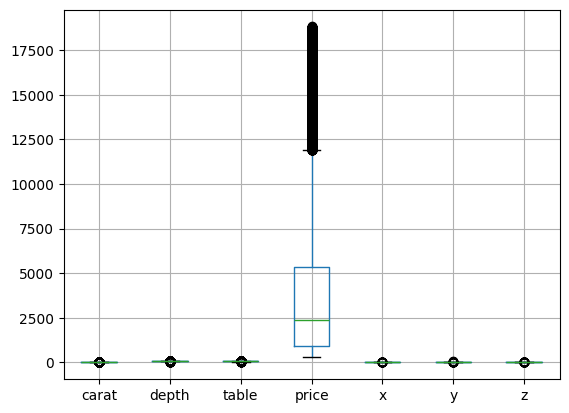

In [18]:
diamonds.boxplot()

In [19]:
diamonds.hist()

array([[<Axes: title={'center': 'carat'}>,
        <Axes: title={'center': 'depth'}>,
        <Axes: title={'center': 'table'}>],
       [<Axes: title={'center': 'price'}>, <Axes: title={'center': 'x'}>,
        <Axes: title={'center': 'y'}>],
       [<Axes: title={'center': 'z'}>, <Axes: >, <Axes: >]], dtype=object)

In [20]:
diamonds.last_valid_index()

53942

In [21]:
diamonds.add_prefix

<bound method NDFrame.add_prefix of        carat        cut color clarity  depth  table  price     x     y     z
0       0.23      Ideal     E     SI2   61.5   55.0    326  3.95  3.98  2.43
1       0.21    Premium     E     SI1   59.8   61.0    326  3.89  3.84  2.31
2       0.23       Good     E     VS1   56.9   65.0    327  4.05  4.07  2.31
3       0.29    Premium     I     VS2   62.4   58.0    334  4.20  4.23  2.63
4       0.31       Good     J     SI2   63.3   58.0    335  4.34  4.35  2.75
...      ...        ...   ...     ...    ...    ...    ...   ...   ...   ...
53938   0.86    Premium     H     SI2   61.0   58.0   2757  6.15  6.12  3.74
53939   0.75      Ideal     D     SI2   62.2   55.0   2757  5.83  5.87  3.64
53940   0.71    Premium     E     SI1   60.5   55.0   2756  5.79  5.74  3.49
53941   0.71    Premium     F     SI1   59.8   62.0   2756  5.74  5.73  3.43
53942   0.70  Very Good     E     VS2   60.5   59.0   2757  5.71  5.76  3.47

[53943 rows x 10 columns]>

In [22]:
diamonds.head(5)

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [23]:
diamonds.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'price', 'x', 'y',
       'z'],
      dtype='object')

In [24]:
import pandas as pd
import cufflinks as cf
from IPython.display import display,HTML

cf.set_config_file(sharing='public',theme='white',offline=True) # write cf.getThemes() to find all themes available


In [25]:
diamonds1 = diamonds.drop(columns=['price','carat'])
diamonds1

,cut,color,clarity,depth,table,x,y,z
0,Ideal,E,SI2,61.5,55.0,3.95,3.98,2.43
1,Premium,E,SI1,59.8,61.0,3.89,3.84,2.31
2,Good,E,VS1,56.9,65.0,4.05,4.07,2.31
3,Premium,I,VS2,62.4,58.0,4.20,4.23,2.63
4,Good,J,SI2,63.3,58.0,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...
53938,Premium,H,SI2,61.0,58.0,6.15,6.12,3.74
53939,Ideal,D,SI2,62.2,55.0,5.83,5.87,3.64
53940,Premium,E,SI1,60.5,55.0,5.79,5.74,3.49
53941,Premium,F,SI1,59.8,62.0,5.74,5.73,3.43


In [26]:
diamonds1.iplot(kind='line', xTitle='depth', yTitle='price',
                    title='Precios Diamantes')

In [27]:
diamonds['table'].iplot(kind='box', color='green', 
                                     yTitle='Population')

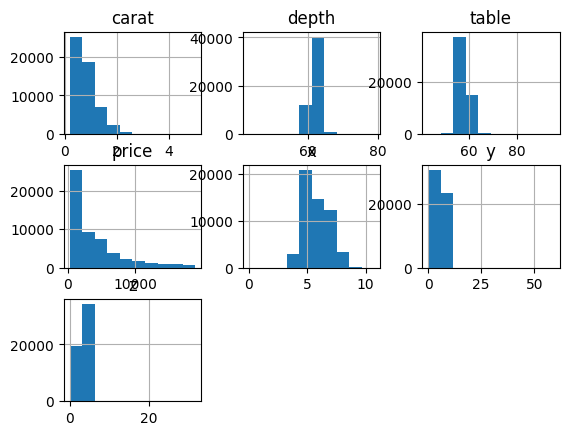

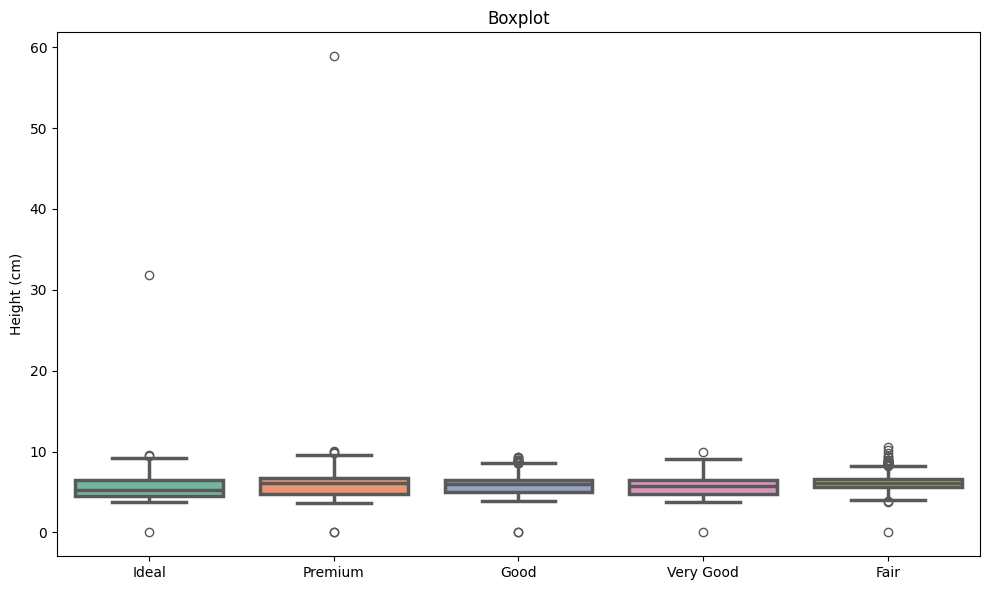

In [28]:
# matplotlib
# plt.boxplot(df_country['height_cm'])

# seaborn
plt.figure(figsize=(10,6), tight_layout=True)

# ax = sns.boxplot(x=df_country['height_cm'], color=sns.color_palette('Set2')[2], linewidth=2.5)
ax = sns.boxplot(data=diamonds1, x='cut', y='y', palette='Set2', linewidth=2.5)
ax.set(title='Boxplot', xlabel='', ylabel='Height (cm)')

#plt.savefig('boxplot.png')
plt.show()

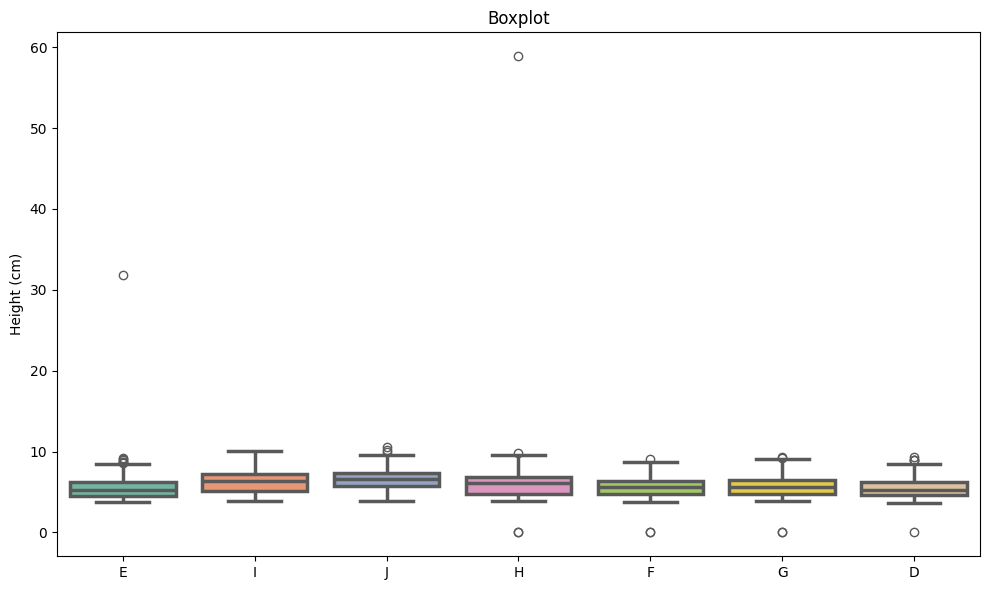

In [29]:
# matplotlib
# plt.boxplot(df_country['height_cm'])

# seaborn
plt.figure(figsize=(10,6), tight_layout=True)

# ax = sns.boxplot(x=df_country['height_cm'], color=sns.color_palette('Set2')[2], linewidth=2.5)
ax = sns.boxplot(data=diamonds1, x='color', y='y', palette='Set2', linewidth=2.5)
ax.set(title='Boxplot', xlabel='', ylabel='Height (cm)')

#plt.savefig('boxplot.png')
plt.show()

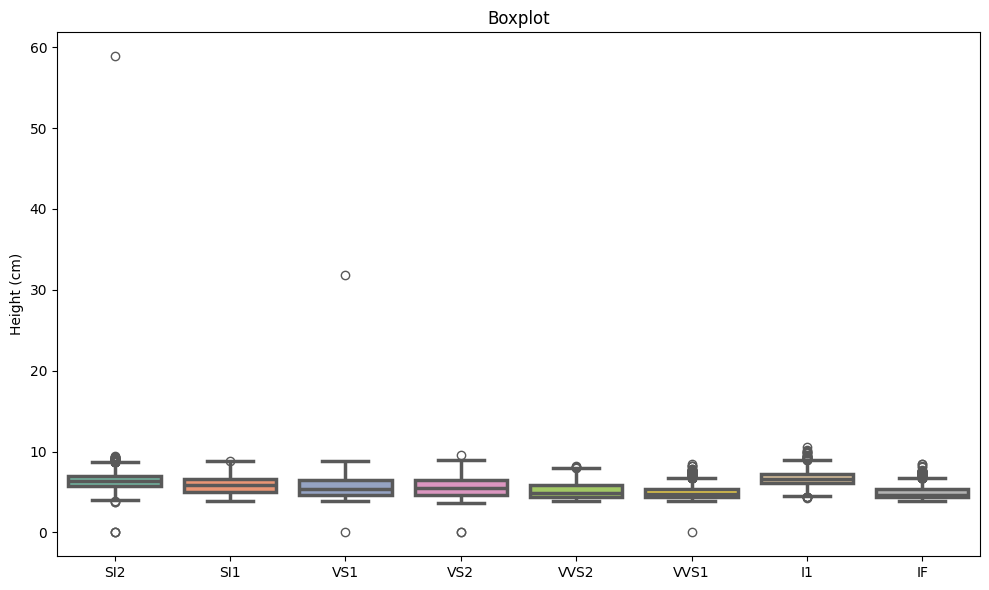

In [30]:
# matplotlib
# plt.boxplot(df_country['height_cm'])

# seaborn
plt.figure(figsize=(10,6), tight_layout=True)

# ax = sns.boxplot(x=df_country['height_cm'], color=sns.color_palette('Set2')[2], linewidth=2.5)
ax = sns.boxplot(data=diamonds1, x='clarity', y='y', palette='Set2', linewidth=2.5)
ax.set(title='Boxplot', xlabel='', ylabel='Height (cm)')

#plt.savefig('boxplot.png')
plt.show()

In [31]:
from sklearn.model_selection import train_test_split

# Extract feature and target arrays
X, y = diamonds.drop('price', axis=1), diamonds[['price']]

In [32]:
# Extract text features
cats = X.select_dtypes(exclude=np.number).columns.tolist()

# Convert to Pandas category
for col in cats:
   X[col] = X[col].astype('category')

In [33]:
X.dtypes

carat       float64
cut        category
color      category
clarity    category
depth       float64
table       float64
x           float64
y           float64
z           float64
dtype: object

In [34]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)

##Ahora, la parte importante: 

XGBoost incluye su propia clase para almacenar conjuntos de datos, llamada DMatrix. 

Es una clase muy optimizada en cuanto a memoria y velocidad. Por eso, convertir conjuntos de datos a este formato es un requisito para la API nativa de XGBoost:


In [35]:
import xgboost as xgb

# Create regression matrices
dtrain_reg = xgb.DMatrix(X_train, y_train, enable_categorical=True)
dtest_reg = xgb.DMatrix(X_test, y_test, enable_categorical=True)

La clase acepta tanto las características de entrenamiento como las etiquetas. Para permitir la codificación automática de las columnas de categoría de Pandas, también establecemos enable_categorical como True.


Después de construir las DMatrices, debes elegir un valor para el parámetro objective. Indica a XGBoost el problema de machine learning que intentas resolver y qué métricas o funciones de pérdida utilizar para resolverlo.

Por ejemplo, para prever el precio de los diamantes, que es un problema de regresión, puedes utilizar el objetivo común reg:squarederror. Normalmente, el nombre del objetivo también contiene el nombre de la función de pérdida del problema. Para la regresión, es habitual utilizar la desviación de la raíz cuadrada media, que minimiza la raíz cuadrada de la suma cuadrática de las diferencias entre los valores real y previsto. Este es el aspecto que tendría la métrica implementada en NumPy:


In [36]:
#import numpy as np

#mse = np.mean((actual - predicted) ** 2)
#rmse = np.sqrt(mse)

Nota sobre la diferencia entre una función de pérdida y una métrica de rendimiento: Los modelos de machine learning utilizan una función de pérdida para minimizar las diferencias entre los valores reales (verdad fundamental) y las previsiones del modelo. Por otra parte, el ingeniero de machine learning elige una métrica (o métricas) para medir la similitud entre la verdad fundamental y las previsiones del modelo.

En resumen: una función de pérdida debe minimizarse, mientras que una métrica debe maximizarse. Durante el entrenamiento se utiliza una función de pérdida para guiar al modelo sobre dónde mejorar. Durante la evaluación se utiliza una métrica para medir el rendimiento global.


Entrenamiento

La función objetivo elegida y cualquier otro hiperparámetro de XGBoost deben especificarse en un diccionario, que, por convención, se llamará params:





In [37]:
# Define hyperparameters
params = {"objective": "reg:squarederror", "tree_method": "gpu_hist"}

Dentro de este params inicial, también configuramos tree_method como gpu_hist, lo que activa la aceleración de la GPU. Si no tienes GPU, puedes omitir el parámetro o configurarlo como hist.

Ahora, establecemos otro parámetro llamado num_boost_round, que significa número de rondas de boosting. Internamente, XGBoost minimiza la función de pérdida RMSE en pequeñas rondas incrementales (explicaremos más sobre esto después). Este parámetro especifica la cantidad de esas rondas.

El número ideal de rondas se halla ajustando los hiperparámetros. De momento, lo estableceremos como 100:


In [38]:
# Define hyperparameters
params = {"objective": "reg:squarederror", "tree_method": "gpu_hist"}

Este código define los hiperparámetros de un modelo de regresión utilizando la biblioteca XGBoost en Python.

• En primer lugar, se define el diccionario params con dos pares clave-valor: "objective": "reg:squarederror" especifica que el objetivo del modelo es minimizar el error cuadrático medio, y "tree_method": "gpu_hist" especifica que el modelo debe utilizar la aceleración de la GPU para la construcción del árbol basada en histogramas.

• A continuación, se define la variable n con un valor de 100, que especifica el número de rondas (iteraciones) de boosting del modelo.

• Por último, se invoca la función xgb.train() con el diccionario params, un conjunto de datos de entrenamiento dtrain_reg y el número de rondas de boosting n.

• Esta función entrena el modelo de regresión XGBoost con los hiperparámetros especificados y devuelve el modelo entrenado.


In [39]:
# Define hyperparameters
params = {"objective": "reg:squarederror", "tree_method": "hist"}

n = 100
model = xgb.train(params=params, dtrain=dtrain_reg, num_boost_round=n)

Evaluación

Durante las rondas de boosting, el objeto modelo ha aprendido todos los patrones posibles del conjunto de entrenamiento. Ahora, debemos medir su rendimiento probándolo con datos no vistos. Ahí es donde entra en juego nuestra dtest_reg DMatrix:


In [40]:
from sklearn.metrics import mean_squared_error

preds = model.predict(dtest_reg)

Este código importa la función mean_squared_error del módulo sklearn.metrics.

• A continuación, utiliza el método predict de un objeto model para hacer previsiones sobre el conjunto de datos dtest_reg.

• Las previsiones se almacenan en la variable preds.

• La función mean_squared_error se puede utilizar para calcular el error cuadrático medio entre los valores previstos y los valores reales de la variable objetivo.


Este paso del proceso se denomina evaluación (o inferencia) del modelo. Una vez generadas las previsiones con predict, las pasas a la función mean_squared_error de Sklearn para compararlas con y_test:


In [41]:
rmse = mean_squared_error(y_test, preds, squared=False)

print(f"RMSE of the base model: {rmse:.3f}")


RMSE of the base model: 541.808


Este código calcula la desviación de la raíz cuadrada media (RMSE) de las previsiones de un modelo de machine learning en un conjunto de datos de prueba.

• La función mean_squared_error del módulo sklearn.metrics se utiliza para calcular el error cuadrático medio entre los valores verdaderos (y_test) y los valores previstos (preds).

• El argumento squared=False se pasa a la función para garantizar que la salida sea la desviación de la raíz cuadrada media en lugar del error cuadrático medio.

• A continuación, la RMSE calculada se imprime en la consola mediante una f-string, que permite insertar variables en una cadena utilizando llaves {}.

• El especificador de formato :.3f se utiliza para redondear la RMSE a tres decimales.


Tenemos una puntuación base de ~541$, que era el rendimiento de un modelo base con parámetros por defecto. 

Hay dos formas de mejorarla: realizando una validación cruzada y ajustando los hiperparámetros. 

Sin embargo, antes de eso, veamos una forma más rápida de evaluar los modelos XGBoost.



Utilizar conjuntos de validación durante el entrenamiento
Entrenar un modelo de machine learning es como lanzar un cohete al espacio. Puedes controlar todo sobre el modelo hasta el lanzamiento, pero, después del lanzamiento, lo único que puedes hacer es quedarte quieto y esperar a que termine.

Sin embargo, el problema de nuestro proceso de entrenamiento actual es que ni siquiera podemos observar hacia dónde se dirige el modelo. Para solucionarlo, utilizaremos matrices de evaluación que nos permitan ver el rendimiento del modelo a medida que mejora incrementalmente a lo largo de las rondas de boosting.

En primer lugar, vamos a configurar de nuevo los parámetros:


In [42]:
params = {"objective": "reg:squarederror", "tree_method": "hist"}
n = 100

In [43]:
evals = [(dtrain_reg, "train"), (dtest_reg, "validation")]

In [44]:
evals = [(dtrain_reg, "train"), (dtest_reg, "validation")]

model = xgb.train(
   params=params,
   dtrain=dtrain_reg,
   num_boost_round=n,
   evals=evals,
)

[0]	train-rmse:2865.21738	validation-rmse:2848.63636
[1]	train-rmse:2083.98797	validation-rmse:2077.10987
[2]	train-rmse:1551.84780	validation-rmse:1556.99242
[3]	train-rmse:1185.05667	validation-rmse:1193.92907
[4]	train-rmse:941.83340	validation-rmse:956.64744
[5]	train-rmse:783.65778	validation-rmse:806.89078
[6]	train-rmse:684.99423	validation-rmse:714.39965
[7]	train-rmse:623.42804	validation-rmse:657.69259
[8]	train-rmse:585.72068	validation-rmse:624.60952
[9]	train-rmse:560.53540	validation-rmse:602.20259
[10]	train-rmse:545.10775	validation-rmse:590.79914
[11]	train-rmse:534.74142	validation-rmse:582.25740
[12]	train-rmse:526.42131	validation-rmse:575.91769
[13]	train-rmse:519.95746	validation-rmse:571.97827
[14]	train-rmse:514.83421	validation-rmse:567.86158
[15]	train-rmse:510.12971	validation-rmse:563.74068
[16]	train-rmse:504.63702	validation-rmse:561.13346
[17]	train-rmse:499.18604	validation-rmse:559.50822
[18]	train-rmse:496.60249	validation-rmse:558.88689
[19]	train-rms

Este código entrena un modelo XGBoost utilizando la función xgb.train().

• El parámetro params es un diccionario de hiperparámetros para el modelo XGBoost.

• El parámetro dtrain_reg son los datos de entrenamiento del modelo, que deben tener forma de DMatrix.

• El parámetro num_boost_round especifica el número de rondas de boosting (es decir, el número de árboles) que hay que construir.

• El parámetro evals es una lista de tuplas, donde cada tupla contiene una DMatriz de datos y una cadena para indicar el nombre del conjunto de datos.

• En este caso, se especifican los conjuntos de datos de entrenamiento y validación.

• La función xgb.train() devuelve el modelo entrenado.


Deberías obtener una salida similar a la siguiente (acortada aquí a solo 10 filas). 

Puedes ver cómo el modelo minimiza la puntuación de ~3931$ a solo 543$.

Lo mejor es que podemos ver el rendimiento del modelo tanto en nuestro conjunto de entrenamiento como en el de validación. Normalmente, la pérdida de entrenamiento será menor que la de validación, puesto que el modelo ya ha visto la primera.


Este código es el resultado del proceso de entrenamiento de un modelo de machine learning mediante XGBoost.

• Los números entre corchetes representan el número de iteración.

• Los valores que preceden a "train-rmse" y "validation-rmse" representan la desviación de la raíz cuadrada media (RMSE) de los conjuntos de entrenamiento y validación, respectivamente, en esa iteración.

• El objetivo del proceso de entrenamiento es minimizar la RMSE en el conjunto de validación y, al mismo tiempo, evitar el sobreajuste en el conjunto de entrenamiento.

• En este ejemplo, el modelo se entrena durante 100 iteraciones.



En los proyectos del mundo real, sueles entrenar para miles de rondas de boosting, lo que significa que hay muchas filas de salida. Para reducirlas, puedes utilizar el parámetro verbose_eval, que obliga a XGBoost a imprimir las actualizaciones de rendimiento cada vebose_eval rondas:


In [45]:
params = {"objective": "reg:squarederror", "tree_method": "hist"}
n = 100

evals = [(dtest_reg, "validation"), (dtrain_reg, "train")]


model = xgb.train(
   params=params,
   dtrain=dtrain_reg,
   num_boost_round=n,
   evals=evals,
   verbose_eval=10) #€very ten rounds


[0]	validation-rmse:2848.63636	train-rmse:2865.21738
[10]	validation-rmse:590.79914	train-rmse:545.10775
[20]	validation-rmse:554.45844	train-rmse:489.22620
[30]	validation-rmse:549.34602	train-rmse:464.70432
[40]	validation-rmse:545.53837	train-rmse:446.90087
[50]	validation-rmse:542.62448	train-rmse:429.18217
[60]	validation-rmse:539.71910	train-rmse:417.09380
[70]	validation-rmse:539.49127	train-rmse:405.84322
[80]	validation-rmse:539.03835	train-rmse:394.18205
[90]	validation-rmse:540.11125	train-rmse:386.48644
[99]	validation-rmse:541.80764	train-rmse:375.61609


Parada anticipada de XGBoost

A estas alturas, ya te habrás dado cuenta de lo importantes que son las rondas de boosting. En general, cuantas más rondas haya, más intentará XGBoost minimizar la pérdida. Sin embargo, esto no significa que la pérdida vaya a bajar siempre. Probemos con 5000 rondas de boosting con la prolijidad de 500:


In [46]:
params = {"objective": "reg:squarederror", "tree_method": "hist"}
n = 5000

evals = [(dtest_reg, "validation"), (dtrain_reg, "train")]


model = xgb.train(
   params=params,
   dtrain=dtrain_reg,
   num_boost_round=n,
   evals=evals,
   verbose_eval=250
)

[0]	validation-rmse:2848.63636	train-rmse:2865.21738
[250]	validation-rmse:549.65434	train-rmse:280.64281
[500]	validation-rmse:561.19401	train-rmse:196.19410
[750]	validation-rmse:567.42141	train-rmse:153.03060
[1000]	validation-rmse:572.17823	train-rmse:122.79993
[1250]	validation-rmse:575.22283	train-rmse:101.33634
[1500]	validation-rmse:576.23809	train-rmse:86.91111
[1750]	validation-rmse:577.49857	train-rmse:74.95081
[2000]	validation-rmse:578.60972	train-rmse:64.82557
[2250]	validation-rmse:579.48710	train-rmse:56.11215
[2500]	validation-rmse:579.72048	train-rmse:49.80625
[2750]	validation-rmse:580.09408	train-rmse:44.62248
[3000]	validation-rmse:580.74728	train-rmse:40.04990
[3250]	validation-rmse:581.03984	train-rmse:36.09396
[3500]	validation-rmse:581.21524	train-rmse:32.73961
[3750]	validation-rmse:581.54587	train-rmse:29.79856
[4000]	validation-rmse:581.79425	train-rmse:27.20959
[4250]	validation-rmse:581.96965	train-rmse:25.25806
[4500]	validation-rmse:582.04514	train-rmse:

Obtenemos la pérdida más baja antes de la ronda 500. Después, aunque la pérdida de entrenamiento siga bajando, la pérdida de validación (la que nos importa) sigue aumentando.

Cuando se le dan un número innecesario de rondas de boosting, XGBoost empieza a sobreajustarse y a memorizar el conjunto de datos. Esto, a su vez, provoca una caída del rendimiento de la validación porque el modelo está memorizando en lugar de generalizando.

Recuerda que queremos el término medio: un modelo que haya aprendido suficientes patrones en el entrenamiento como para ofrecer el mayor rendimiento en el conjunto de validación. Entonces, ¿cómo hallamos el número perfecto de rondas de boosting?

Utilizaremos una técnica llamada parada anticipada. La parada anticipada obliga a XGBoost a vigilar la pérdida de validación y, si deja de mejorar durante un número especificado de rondas, deja de entrenar automáticamente.

Esto significa que podemos establecer un número elevado de rondas de boosting siempre que establezcamos un número razonable de rondas de parada anticipada.

Por ejemplo, utilicemos 10 000 rondas de boosting y establezcamos el parámetro early_stopping_rounds como 50. De este modo, XGBoost detendrá automáticamente el entrenamiento si la pérdida de validación no mejora durante 50 rondas consecutivas.



In [47]:
n = 10000


model = xgb.train(
   params=params,
   dtrain=dtrain_reg,
   num_boost_round=n,
   evals=evals,
   verbose_eval=50,
   # Activate early stopping
   early_stopping_rounds=50
)


[0]	validation-rmse:2848.63636	train-rmse:2865.21738
[50]	validation-rmse:542.62448	train-rmse:429.18217
[100]	validation-rmse:541.79709	train-rmse:375.20024
[150]	validation-rmse:540.85140	train-rmse:337.34112
[200]	validation-rmse:545.67712	train-rmse:304.22279
[250]	validation-rmse:549.65434	train-rmse:280.64281
[300]	validation-rmse:551.34266	train-rmse:260.10977
[350]	validation-rmse:553.17873	train-rmse:241.12475
[400]	validation-rmse:556.35654	train-rmse:222.44055
[450]	validation-rmse:558.64229	train-rmse:208.09446
[500]	validation-rmse:561.19401	train-rmse:196.19410
[550]	validation-rmse:562.98732	train-rmse:186.64432
[600]	validation-rmse:565.09078	train-rmse:176.27748
[650]	validation-rmse:565.69804	train-rmse:167.89851
[700]	validation-rmse:566.32199	train-rmse:160.35414
[750]	validation-rmse:567.42141	train-rmse:153.03060
[800]	validation-rmse:568.40648	train-rmse:145.74217
[850]	validation-rmse:569.34491	train-rmse:139.75383
[900]	validation-rmse:570.16646	train-rmse:134.

Como puedes ver, el entrenamiento se detuvo después de la 167.ª ronda porque la pérdida dejó de mejorar durante 50 rondas.
OOOOOJOOOOOOOO


Validación cruzada en XGBoost

Al principio del tutorial, reservamos el 25 % del conjunto de datos para las pruebas. El conjunto de prueba nos permitiría simular las condiciones de un modelo en producción, donde debe generar previsiones para datos no vistos.

Sin embargo, un único conjunto de prueba no bastaría para medir con precisión cómo se comportaría un modelo en la producción. Por ejemplo, si realizamos el ajuste de hiperparámetros utilizando un único conjunto de entrenamiento y un único conjunto de prueba, los conocimientos sobre el conjunto de prueba seguirían "filtrándose". ¿Cómo?

Como intentamos hallar el mejor valor de un hiperparámetro comparando el rendimiento de validación del modelo en el conjunto de prueba, acabaremos con un modelo configurado para rendir bien solo en ese conjunto de prueba concreto. En lugar de eso, queremos un modelo que funcione bien en todos los ámbitos, en cualquier conjunto de prueba que le propongamos.

Una posible solución consiste en dividir los datos en tres conjuntos. El modelo se entrena con el primer conjunto, el segundo se utiliza para la evaluación y el ajuste de hiperparámetros y el tercero es el último, en el que probamos el modelo antes de la producción.

Sin embargo, cuando los datos son limitados, dividirlos en tres conjuntos hará que el conjunto de entrenamiento sea escaso, lo que perjudica al rendimiento del modelo.

La solución a todos estos problemas es la validación cruzada. En la validación cruzada, seguimos teniendo dos conjuntos: de entrenamiento y de prueba.

Mientras el conjunto de prueba espera en la esquina, dividimos el de entrenamiento en 3, 5, 7 o k divisiones o pliegues. A continuación, entrenamos el modelo k veces. Cada vez, utilizamos k-1 partes para el entrenamiento y la k-ésimaparte final para la validación. Este proceso se denomina validación cruzada de k pliegues:


In [48]:
params = {"objective": "reg:squarederror", "tree_method": "hist"}
n = 1000

results = xgb.cv(
   params, dtrain_reg,
   num_boost_round=n,
   nfold=5,
   early_stopping_rounds=20
)

La única diferencia con la función de entrenamiento es añadir el parámetro nfold para especificar el número de divisiones. El objeto de resultados es ahora un DataFrame que contiene los resultados de cada pliegue:


In [49]:
results.head()

,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,2865.596908,2.403354,2868.453258,13.785401
1,2083.221540,3.219126,2089.060203,10.730348
2,1546.799222,2.513438,1556.027739,8.839548
3,1181.880342,3.342802,1194.763176,9.285412
4,939.751058,2.820695,958.887150,8.722928


Tiene el mismo número de filas que el número de rondas de boosting. Cada fila es la media de todas las divisiones de esa ronda. Por tanto, para hallar la mejor puntuación, tomamos el mínimo de la columna test-rmse-mean:


In [50]:
best_rmse = results['test-rmse-mean'].min()

best_rmse


559.652958487479

Ten en cuenta que este método de validación cruzada se utiliza para ver el verdadero rendimiento del modelo. Una vez satisfecho con su puntuación, debes volver a entrenarlo con todos los datos antes de implementarlo.


In [51]:
# sweetviz es un paquete de análisis exploratorio automático, una alternativa también es pandas-profiling
import sweetviz as sv
#analyzing the dataset
advert_report = sv.analyze(diamonds)

                                             |          | [  0%]   00:00 -> (? left)

In [52]:
advert_report

In [53]:
advert_report.show_html('PricesDiamonds.html')

Report PricesDiamonds.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [54]:
diamonds.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'price', 'x', 'y',
       'z'],
      dtype='object')

In [55]:
diamonds.dtypes

carat      float64
cut         object
color       object
clarity     object
depth      float64
table      float64
price        int64
x          float64
y          float64
z          float64
dtype: object

In [56]:
diamonds.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [57]:
diamonds1 = diamonds.drop(columns='cut')
diamonds1 = diamonds1.drop(columns='clarity')
diamonds1 = diamonds1.drop(columns='color')
diamonds1

,carat,depth,table,price,x,y,z
0,0.23,61.5,55.0,326,3.95,3.98,2.43
1,0.21,59.8,61.0,326,3.89,3.84,2.31
2,0.23,56.9,65.0,327,4.05,4.07,2.31
3,0.29,62.4,58.0,334,4.20,4.23,2.63
4,0.31,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...
53938,0.86,61.0,58.0,2757,6.15,6.12,3.74
53939,0.75,62.2,55.0,2757,5.83,5.87,3.64
53940,0.71,60.5,55.0,2756,5.79,5.74,3.49
53941,0.71,59.8,62.0,2756,5.74,5.73,3.43


##k-means


  File "c:\Users\Javier Suárez\AppData\Local\Programs\Python\Python312\Lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


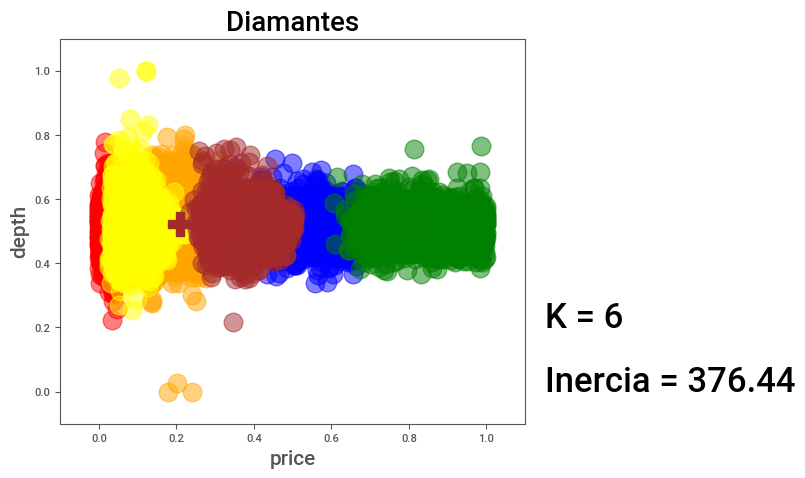

In [58]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans


escalador = MinMaxScaler().fit(diamonds1.values)

diamantes = pd.DataFrame(escalador.transform(diamonds1.values),
                       columns=["carat", "depth", "table", "price", "x", "y", "z"])

kmeans = KMeans(n_clusters=6).fit(diamantes.values)

diamantes["cluster"] = kmeans.labels_

# Instrucciones para graficar los clusters 

plt.figure(figsize=(6, 5), dpi=100)

colores = ["red", "blue", "orange", "green", "yellow", "brown"]

for cluster in range(kmeans.n_clusters):
    plt.scatter(diamantes[diamantes["cluster"] == cluster]["price"],
                diamantes[diamantes["cluster"] == cluster]["depth"],
                marker="o", s=180, color=colores[cluster], alpha=0.5)
    
    plt.scatter(kmeans.cluster_centers_[cluster][0], 
                kmeans.cluster_centers_[cluster][1],
                marker="P", s=280, color=colores[cluster])

plt.title("Diamantes", fontsize=20)
plt.xlabel("price", fontsize=15)
plt.ylabel("depth", fontsize=15)
plt.text(1.15, 0.2, "K = %i" % kmeans.n_clusters, fontsize=25)
plt.text(1.15, 0, "Inercia = %0.2f" % kmeans.inertia_, fontsize=25)
plt.xlim(-0.1, 1.1)
plt.ylim(-0.1, 1.1) 
  

plt.show()

del diamantes["cluster"] 

## KNN-Bagging


## fuente:// codigo Maquina


N Muestreos para N Modelos

In [59]:
for i in range(5):
    print(diamonds1.sample(frac=1/10), "\n")
    

       carat  depth  table  price     x     y     z
33405   0.28   62.4   56.0    828  4.20  4.16  2.61
52299   0.25   59.4   62.0    548  4.12  4.13  2.45
44824   0.39   60.1   57.0   1624  4.74  4.77  2.85
3131    0.73   62.8   57.0   3327  5.75  5.78  3.62
38685   0.30   61.1   55.0   1041  4.36  4.38  2.67
...      ...    ...    ...    ...   ...   ...   ...
8407    1.07   62.0   57.0   4401  6.58  6.55  4.07
31408   0.30   61.1   57.0    764  4.32  4.35  2.65
37312   0.31   60.9   56.0    979  4.39  4.41  2.68
12650   1.22   62.3   57.0   5296  6.85  6.80  4.25
42224   0.52   62.9   56.0   1290  5.12  5.08  3.21

[5394 rows x 7 columns] 

       carat  depth  table  price     x     y     z
935     0.84   63.8   57.0   2885  5.95  6.00  3.81
47021   0.56   61.8   59.0   1819  5.27  5.34  3.28
46073   0.50   62.9   55.0   1736  5.12  5.08  3.21
23433   1.62   59.6   59.0  11427  7.59  7.67  4.55
21125   1.52   59.9   60.0   9290  7.46  7.49  4.48
...      ...    ...    ...    ...   .

In [60]:
diamonds1["size_price"] = diamonds1.apply(
    lambda row: row.x>5.50, 1,0)


In [61]:
diamonds1

,carat,depth,table,price,x,y,z,size_price
0,0.23,61.5,55.0,326,3.95,3.98,2.43,False
1,0.21,59.8,61.0,326,3.89,3.84,2.31,False
2,0.23,56.9,65.0,327,4.05,4.07,2.31,False
3,0.29,62.4,58.0,334,4.20,4.23,2.63,False
4,0.31,63.3,58.0,335,4.34,4.35,2.75,False
...,...,...,...,...,...,...,...,...
53938,0.86,61.0,58.0,2757,6.15,6.12,3.74,True
53939,0.75,62.2,55.0,2757,5.83,5.87,3.64,True
53940,0.71,60.5,55.0,2756,5.79,5.74,3.49,True
53941,0.71,59.8,62.0,2756,5.74,5.73,3.43,True


In [62]:
diamonds1.dtypes

carat         float64
depth         float64
table         float64
price           int64
x             float64
y             float64
z             float64
size_price       bool
dtype: object

In [63]:
diamonds1.size_price.value_counts(normalize = True) * 100

size_price
True     54.075598
False    45.924402
Name: proportion, dtype: float64

In [64]:
diamonds1['size_price']=diamonds1.size_price.map({False:0, True:1})
diamonds1

,carat,depth,table,price,x,y,z,size_price
0,0.23,61.5,55.0,326,3.95,3.98,2.43,0
1,0.21,59.8,61.0,326,3.89,3.84,2.31,0
2,0.23,56.9,65.0,327,4.05,4.07,2.31,0
3,0.29,62.4,58.0,334,4.20,4.23,2.63,0
4,0.31,63.3,58.0,335,4.34,4.35,2.75,0
...,...,...,...,...,...,...,...,...
53938,0.86,61.0,58.0,2757,6.15,6.12,3.74,1
53939,0.75,62.2,55.0,2757,5.83,5.87,3.64,1
53940,0.71,60.5,55.0,2756,5.79,5.74,3.49,1
53941,0.71,59.8,62.0,2756,5.74,5.73,3.43,1


Escalamiento de los Datos

In [65]:
from sklearn.preprocessing import MinMaxScaler

diamondsEsc = MinMaxScaler().fit_transform(diamonds1)
diamondsEsc

array([[0.00623701, 0.51388889, 0.23076923, ..., 0.06757216, 0.07641509,
        0.        ],
       [0.002079  , 0.46666667, 0.34615385, ..., 0.06519525, 0.07264151,
        0.        ],
       [0.00623701, 0.38611111, 0.42307692, ..., 0.06910017, 0.07264151,
        0.        ],
       ...,
       [0.10602911, 0.48611111, 0.23076923, ..., 0.09745331, 0.10974843,
        1.        ],
       [0.10602911, 0.46666667, 0.36538462, ..., 0.09728353, 0.10786164,
        1.        ],
       [0.1039501 , 0.48611111, 0.30769231, ..., 0.09779287, 0.1091195 ,
        1.        ]])

In [66]:
diamondsEsc.size

431544

In [67]:
import cufflinks as cf
from IPython.display import display,HTML

cf.set_config_file(sharing='public',theme='white',offline=True) # write cf.getThemes() to find all themes available


Visualización de los Datos

carat, depth, table,x,y,z -> price


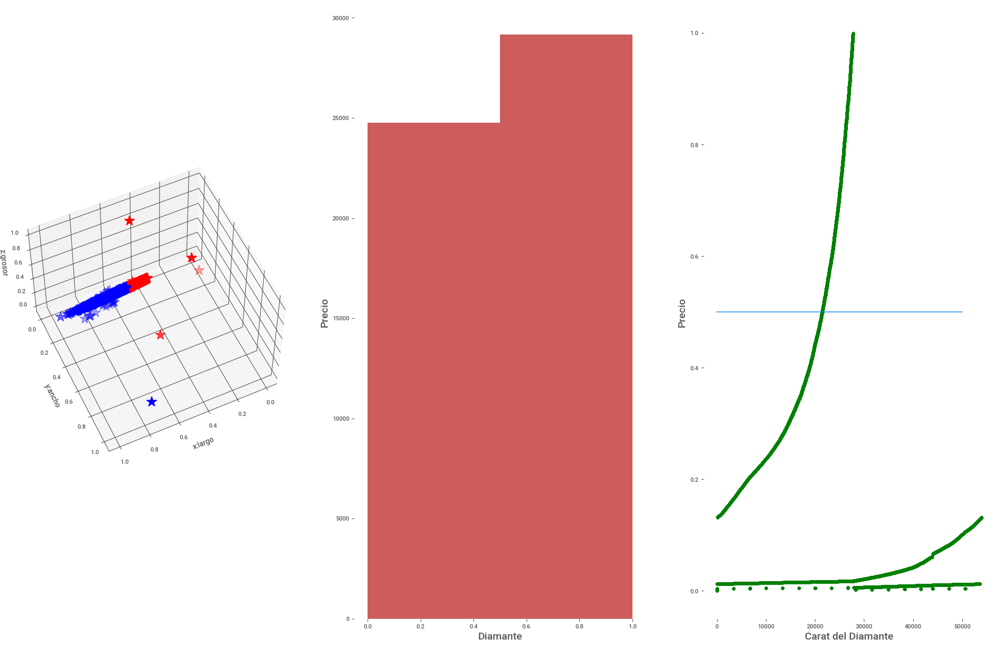

In [68]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(24, 15))

# Gráfica de dispersión -> x, y y z
ax = fig.add_subplot(1, 3, 1, projection="3d")
colores = ("red", "blue")
for clase in (0, 1):
    ax.scatter(diamondsEsc.T[4][diamondsEsc.T[7]==clase], 
               diamondsEsc.T[5][diamondsEsc.T[7]==clase], 
               diamondsEsc.T[6][diamondsEsc.T[7]==clase],
               marker="*", c=colores[clase], s=200)

ax.set_xlabel("x:largo", size=10)
ax.set_ylabel("y:ancho", size=10)
ax.set_zlabel("z:grosor", size=10)
ax.view_init(55, 65)
# Histograma -> Dimensión del diamante
ax = fig.add_subplot(1, 3, 2)
ax.hist(diamondsEsc.T[7], bins=2, histtype="barstacked", color="indianred")
ax.set_ylabel("Precio", size=14)
ax.set_xlabel("Diamante", size=14)
plt.setp(ax.spines.values(), linewidth=0)
# Visualización del precio de los diamantes
ax = fig.add_subplot(1, 3, 3)
ax.plot(diamondsEsc.T[3], marker="o", linewidth=0, color="green")
ax.plot([0.5]*50000, linewidth=1)
ax.set_ylabel("Precio", size=14)
ax.set_xlabel("Carat del Diamante", size=14)
plt.setp(ax.spines.values(), linewidth=0)
plt.show()


In [69]:
diamonds1.iplot()

In [70]:
diamonds2 = diamonds1.drop(columns = ['price','size_price','carat','depth','table'])

In [71]:
diamonds2.iplot(kind='bar', xTitle='cantidad de diamantes',
                           yTitle='dimensiones')

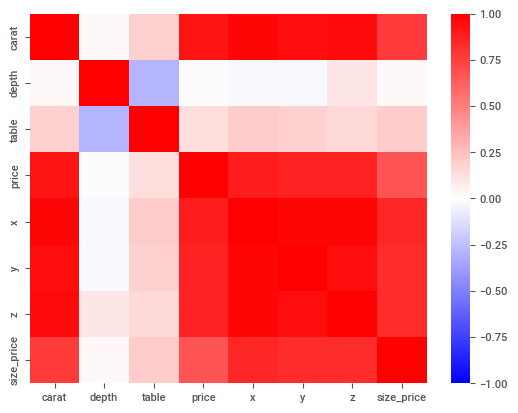

In [72]:
import seaborn as sns

sns.heatmap(diamonds1.corr(), cmap='bwr', vmin=-1, vmax=1)
plt.show()

In [73]:
# Define a list of columns to analyze 
sample = ['depth','carat', 'table'] 

# Iterate through the specified columns 
for i, col in enumerate(sample): 
	# Group the DataFrame by the current column and calculate the mean of 'charges' 
	grouped_data = diamonds1[[col, 'price']].groupby(col).mean() 
	
	# Print the mean charges for each group within the current column 
	print(grouped_data) 
	
	# Print a blank line to separate the output for different columns 
	print()


        price
depth        
43.0   4206.0
44.0   4032.0
50.8   6727.0
51.0    945.0
52.2   1895.0
...       ...
72.2   2438.0
72.9   2691.0
73.6   1789.0
78.2   1262.0
79.0   2579.0

[184 rows x 1 columns]

              price
carat              
0.20     365.166667
0.21     380.222222
0.22     391.400000
0.23     486.143345
0.24     505.185039
...             ...
4.00   15984.000000
4.01   15223.000000
4.13   17329.000000
4.50   18531.000000
5.01   18018.000000

[273 rows x 1 columns]

         price
table         
43.0    4997.0
44.0     474.0
49.0    2290.5
50.0    8995.5
50.1    3353.0
...        ...
71.0    1633.0
73.0    2406.5
76.0    2362.0
79.0    2301.0
95.0   13387.0

[127 rows x 1 columns]



######


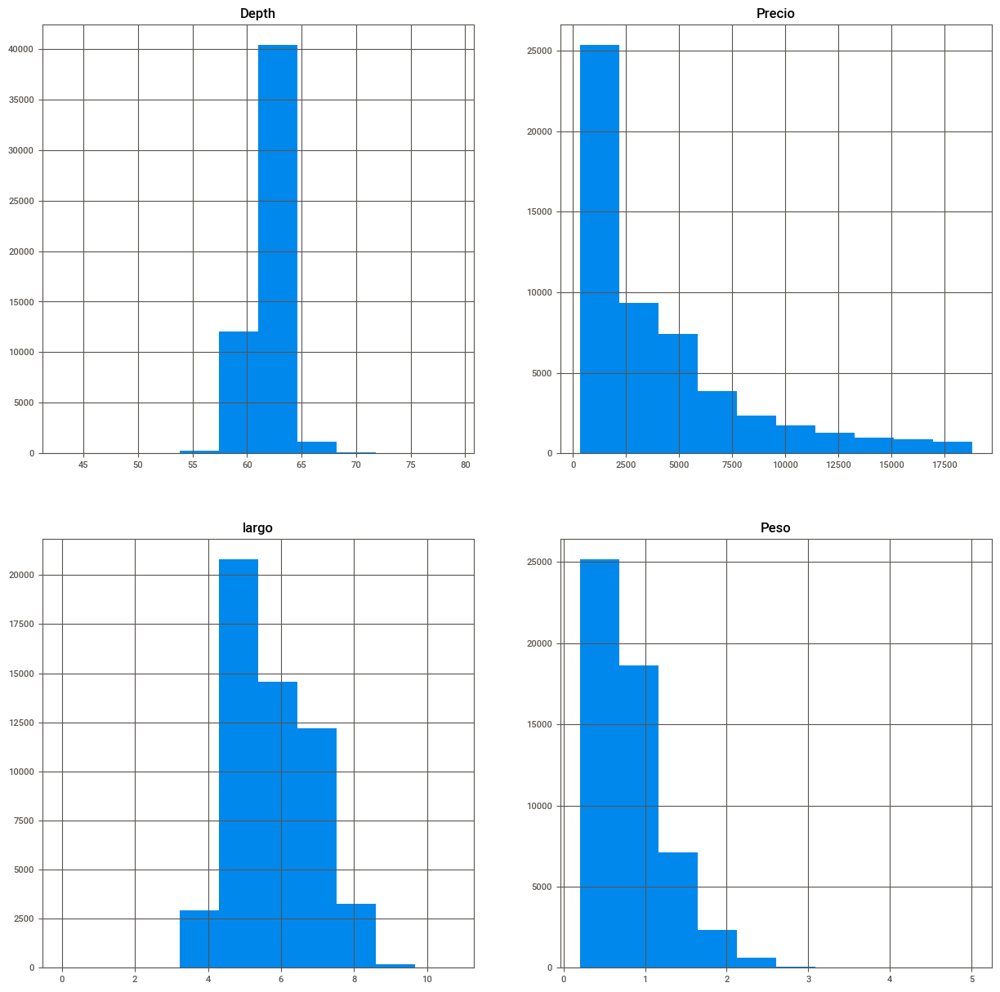

<Figure size 1500x1500 with 0 Axes>

In [74]:
fig, axs = plt.subplots(2,2,figsize=(15,15))
axs[0,0].set_title('Depth')
diamonds1['depth'].hist(ax=axs[0,0])
axs[0,1].set_title('Precio')
diamonds1['price'].hist(ax=axs[0,1])
axs[1,0].set_title('largo')
diamonds1['x'].hist(ax=axs[1,0])
axs[1,1].set_title('Peso')
diamonds1['carat'].hist(ax=axs[1,1])



plt.figure(figsize=(15,15))
plt.show()


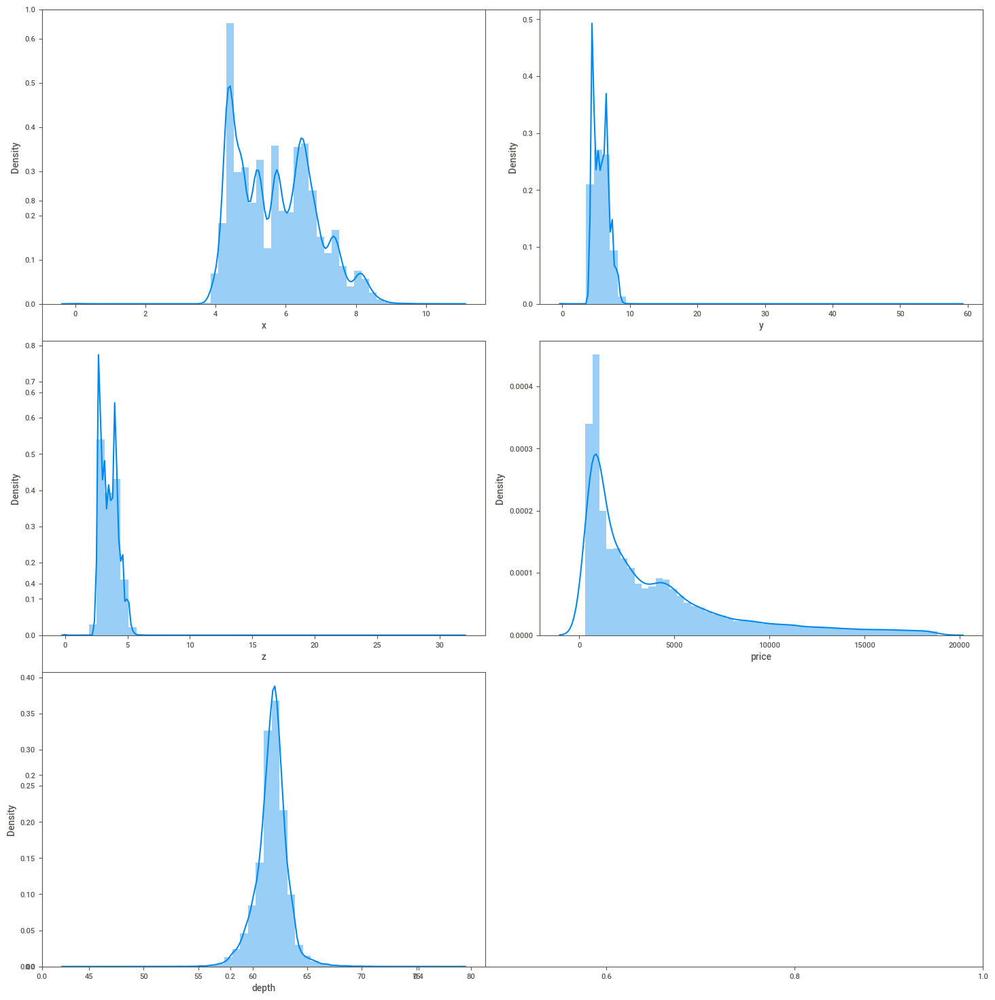

In [75]:
import seaborn as sns

# Set the figure size for the subplots 
plt.subplots(figsize=(15, 15)) 

# Define the list of numeric columns to visualize 
sample = ['x', 'y', 'z','price','depth'] 

# Loop through the specified columns 
for i, col in enumerate(sample): 
	# Create subplots in a 3x2 grid 
	plt.subplot(3, 2, i + 1) 
	
	# Create a distribution plot for the current numeric column 
	sns.distplot(diamonds1[col]) 
	
# Adjust subplot layout for better presentation 
plt.tight_layout() 

# Display the subplots 
plt.show() 


## €jemplo...



## Creación de Meta-modelos Bagging

Estimador base: K-vecinos más cercanos KNN


## Un clasificador Bagging.

Un clasificador Bagging es un metaestimador de conjunto que ajusta los clasificadores base a subconjuntos aleatorios del conjunto de datos original y luego agrega sus predicciones individuales (ya sea por votación o por promedio) para formar una predicción final. Este metaestimador se puede utilizar normalmente como una forma de reducir la varianza de un estimador de caja negra (por ejemplo, un árbol de decisión), introduciendo la aleatorización en su procedimiento de construcción y luego formando un conjunto a partir de él.


Este algoritmo abarca varios trabajos de la literatura. Cuando se extraen subconjuntos aleatorios del conjunto de datos como subconjuntos aleatorios de las muestras, este algoritmo se conoce como Pasting. Si las muestras se extraen con reemplazo, el método se conoce como Bagging. Cuando se extraen subconjuntos aleatorios del conjunto de datos como subconjuntos aleatorios de las características, el método se conoce como Random Subspaces. Por último, cuando los estimadores base se construyen sobre subconjuntos tanto de muestras como de características, el método se conoce como Random Patches.


In [76]:
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import BaggingRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score

# Separando las características de las variables objetivo
datos = diamondsEsc.T[:-5].T # features
clase = diamondsEsc.T[7] # clase de salario
valor = diamondsEsc.T[3] # salario numérico

# Clasificador base y regresor base 
clasificador = KNeighborsClassifier(n_neighbors=3)
regresor = KNeighborsRegressor(n_neighbors=3)

n = 50 # números de modelos: 1 vs 50

# Modelos bagging para clasificaión y regresión con los parámetros por defectos.
meta_clasificador = BaggingClassifier().fit(datos, clase)

meta_regresor = BaggingRegressor().fit(datos, valor)

# Métricas relevantes para clasificación y determinación
print("Accuracy:", 
      accuracy_score(clase, meta_clasificador.predict(datos)))
print("Coeficiente de determinación:", 
      r2_score(valor, meta_regresor.predict(datos)))

Accuracy: 0.9990730956750644
Coeficiente de determinación: 0.9516763329349663
